# Assignment 3
## Decision Trees and Random Forests for Regression, Part 1

### About this notebook

The general description and instructions as well as questions for the walk through Part 1 of the task (this notebook) are found in the Assignment description in Canvas!


In [64]:
# YOU DON'T HAVE TO RUN THIS IF EVERYTHING IS ALREADY INSTALLED CORRECTLY
!pip3 install --upgrade pip
!pip3 install graphviz
!pip3 install dtreeviz
!pip3 install numpy scipy

  Using cached pip-24.3.1-py3-none-any.whl.metadata (3.7 kB)
Using cached pip-24.3.1-py3-none-any.whl (1.8 MB)


ERROR: To modify pip, please run the following command:
C:\Users\joaqu\anaconda3\envs\ML\python.exe -m pip install --upgrade pip


## Steps 0-2: Dataset(s)

**Step 0:** First, load the dataset. Ultimately, you should be working with the California housing data, but for quicker test runs, it might help to first start out with the Diabetes data.

In [65]:
from sklearn.datasets import load_diabetes
from sklearn.datasets import fetch_california_housing
from ConceptDataRegr import ConceptDataRegr
from sklearn.model_selection import train_test_split, cross_val_score

import ssl
ssl._create_default_https_context = ssl._create_unverified_context

#test_case = 'diabetes'
test_case = 'california'

if test_case == 'california':
    dataset = fetch_california_housing()
elif test_case == 'diabetes':
    dataset = load_diabetes()
else:
    raise ValueError('Unknown test case')

X = dataset.data
y = dataset.target


**Step 1:** Get some information about the dataset you're looking at

In [66]:
if test_case == 'california' :
    print("target:", list(dataset.target_names))
print("features:", list(dataset.feature_names))
print("description:", dataset.DESCR)


target: ['MedHouseVal']
features: ['MedInc', 'HouseAge', 'AveRooms', 'AveBedrms', 'Population', 'AveOccup', 'Latitude', 'Longitude']
description: .. _california_housing_dataset:

California Housing dataset
--------------------------

**Data Set Characteristics:**

    :Number of Instances: 20640

    :Number of Attributes: 8 numeric, predictive attributes and the target

    :Attribute Information:
        - MedInc        median income in block group
        - HouseAge      median house age in block group
        - AveRooms      average number of rooms per household
        - AveBedrms     average number of bedrooms per household
        - Population    block group population
        - AveOccup      average number of household members
        - Latitude      block group latitude
        - Longitude     block group longitude

    :Missing Attribute Values: None

This dataset was obtained from the StatLib repository.
https://www.dcc.fc.up.pt/~ltorgo/Regression/cal_housing.html

The targe

**Step 2:** Split the data into train, validation and test sets.

In [67]:
# splitting using the proper SKLearn tools
train_ratio = 0.70
validation_ratio = 0.15
test_ratio = 0.15
X = dataset.data
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=1 - train_ratio, random_state=0)
X_val, X_test, y_val, y_test = train_test_split(X_test, y_test, test_size=test_ratio/(test_ratio + validation_ratio), random_state=0)

# The train set is used to train the model
# The validation set is used during the model development process to tune the hyperparameters and evaluate the model's performance while training
# It helps prevent overfitting to the training set by providing feedback on the model's performance on data that it hasn't seen before (generalization)
# The test set is used to evaluate the model's performance after the model has been trained and tuned. Used only once.

## Step 3: The SKLearn Decision Tree Regressor

Set up and fit a DecisionTreeRegressor with *random_state=0* ([DecisionTreeRegressor](https://scikit-learn.org/stable/modules/generated/sklearn.tree.DecisionTreeRegressor.html?highlight=decision+tree)), use its *score* method to evaluate it in a simple step. Check also out [cross_val_score](https://scikit-learn.org/stable/modules/generated/sklearn.model_selection.cross_val_score.html)
to learn about a different type of evaluation tool. Use the documentation where needed. Be prepared to answer "random" questions posed by the TA. 

In [68]:
from sklearn.tree import DecisionTreeRegressor

# set up your first regressor, e.g.: regressor1 = ...
regressor1 = DecisionTreeRegressor(random_state=0)


In [69]:
from sklearn.model_selection import cross_val_score
# apply cross_val_score on your regressor1 (obs, this is done on training data) and see what happens
# go for cv=10 for a start, but you can also test different values

cv_scores = cross_val_score(regressor1, X_train, y_train, cv=10)
print("Cross validation scores for regressor 1:", cv_scores)
print("Mean CV accuracy for regressor 1:", cv_scores.mean())
# The cross_val_score does both the fitting and the scoring of the model, that is why we send the training data and the unfitted model as parameters.
# The scoring is conducted by folding the data into 10 parts (cv=10) and training the model on 9 parts and testing on the 10th part, doing this 10 times.

Cross validation scores for regressor 1: [0.58069651 0.63561316 0.59517376 0.6015455  0.58837564 0.60948464
 0.59118007 0.56681236 0.52772062 0.67589022]
Mean CV accuracy for regressor 1: 0.5972492479953516


In [70]:
# fit your regressor1 to training data and evaluate with 'score' on the test data
regressor1.fit(X_train, y_train) # Regressor1 is a decision tree model for regression tasks (continuous values)
print("Regressor 1 score on validation set:", regressor1.score(X_val, y_val))
# The score method returns the coefficient of determination R^2 of the prediction. It is defined as (1 - u/v),
# where u is the residual sum of squares ((y_true - y_pred) ** 2).sum() and v is the total sum of squares ((y_true - y_true.mean()) ** 2).sum().
# The best possible score is 1.0 and it can be negative (because the model can be arbitrarily worse). A constant model that always predicts the expected value of y,
# disregarding the input features, would get a R^2 score of 0.0.


# The .fit and then score might lead to overfitting to the training set. While the cross_val_score function helps detect overfitting due to multiple evaluations on unseen data

Regressor 1 score on validation set: 0.5913806202834724


## Step 4: Decision Tree Parameters
Now, work with two parameters, *max_depth* and *min_samples_leaf*. Analyse the documentation to understand what they do. Create two more regressors, where you experiment with different settings for those parameters, e.g. 1 for *max_depth* and 20 for *min_samples_leaf*. Evaluate with both *cross_val_score* and *score*.
Explain the outcomes.

In [71]:
# regressor2...
# The max_depth parameter is used to control the maximum depth of the tree. The deeper the tree, the more complex the model and the more likely to overfit.
# The min_samples_leaf parameter is used to control the minimum number of samples required to be at a leaf node. The higher the number, the less likely to overfit.
regressor2 = DecisionTreeRegressor(random_state=0, max_depth=1)
cv_scores = cross_val_score(regressor2, X_train, y_train, cv=10)
print("Cross validation scores for regressor 2:", cv_scores)
print("Mean CV accuracy for regressor 2:", cv_scores.mean())

regressor2.fit(X_train, y_train)
score = regressor2.score(X_val, y_val)
print("Regressor 2 score on validation set:", score)

Cross validation scores for regressor 2: [0.3093173  0.31084997 0.3238698  0.26062284 0.34982138 0.28834936
 0.31131296 0.32220031 0.26295319 0.36589174]
Mean CV accuracy for regressor 2: 0.3105188838001503
Regressor 2 score on validation set: 0.2977964241669544


In [72]:
# regressor3 ...

regressor3 = DecisionTreeRegressor(random_state=0, min_samples_leaf=20)
cv_scores = cross_val_score(regressor3, X_train, y_train, cv=10)
print("Cross validation scores for regressor 3:", cv_scores)
print("Mean CV accuracy for regressor 3:", cv_scores.mean())

regressor3.fit(X_train, y_train)
score = regressor3.score(X_val, y_val)
print("Regressor 3 score on validation set:", score)

Cross validation scores for regressor 3: [0.70559734 0.7130729  0.73822167 0.70004541 0.73592394 0.72537751
 0.70869509 0.70540392 0.69394141 0.74850674]
Mean CV accuracy for regressor 3: 0.7174785915545112
Regressor 3 score on validation set: 0.7023197194670979


## Steps 5-6: Decision Tree Visualization

The next cells give examples how to visualize regressor2 and regressor3.

**Step 5:** Visualisation with GraphViz, which was used for the lecture slides, but with rectangular nodes

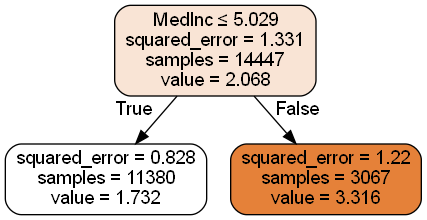

In [73]:
from sklearn import tree
import graphviz
from IPython.display import Image

# The visualisation below assumes a regressor called 'regressor2'. 
# Change in the code below if your naming above is different

dot_data = tree.export_graphviz(regressor2, feature_names=dataset.feature_names, out_file=None, filled=True, rounded=True, special_characters=True)
graph = graphviz.Source(dot_data, format="png") 
graph.render("decision_tree_regressor2")
Image("decision_tree_regressor2.png")

In [74]:
# The visualisation below assumes a regressor called 'regressor3'. 
# Change in the code below if your naming above is different

dot_data = tree.export_graphviz(regressor3, feature_names=dataset.feature_names, out_file=None, filled=True, rounded=True, special_characters=True)
graph = graphviz.Source(dot_data, format="png") 
graph.render("decision_tree_regressor3")
Image("decision_tree_regressor3.png")

dot: graph is too large for cairo-renderer bitmaps. Scaling by 0.605473 to fit


**Step 6:** Another way to visualize the decision trees is to use dtreeviz. To make these plots it takes quite some time, so we recommend to use this visualization tool for trees with few nodes only. 

In [75]:
import dtreeviz

# The visualisation below assumes a regressor called 'regressor2'. 
# Change in the code below if your naming above is different

viz = dtreeviz.model(regressor2, X, y,
                target_name="target",
                feature_names=dataset.feature_names)

viz.view(fontname="monospace", scale=3) # this displays the output inside the notebook.


# If you want to store the output in a file use:
#viz.save("dtreeviz.svg")

# In the top node: the scatter plot shows the relationship between the feature s5 (X-axis) and the target variable (y-axis).
# The decision tree splits the data at a specific treshold value of s5 = 0.0217, indicated by the vertical line.
# The dashed horizontal lines indicate the average target value for the samples of the corresponding split.
# Feature importance: The feature s5 is selected as the most important at this level because it minimizes the error in the target variable. (R^2 score, Residual sum of squares)
# Preditction: The decision tree predicts the target based on the mean target value of samples in each node. In this case:
# If s5 <= 0.0217, the predicted target is 121.89
# If s5 > 0.0217, the predicted target is 218.19


## Steps 7-9: Explainability

**Step 7:** If you want to visualize (explain) the decision path for one prediction, you can also use dtreeviz:

In [76]:
import numpy as np

# The visualisation below assumes a regressor called 'regressor2'. 
# Change in the code below if your naming above is different

sample = X_test[np.random.randint(0, len(X_test)),:] # random sample from training

viz = dtreeviz.model(regressor2, X, y,
                target_name="target",
                feature_names=dataset.feature_names)

viz.view(fontname="monospace", scale=3, x = sample)

**Step 8:** For bigger graphs you just show the decision path

In [77]:
# The visualisation below assumes a regressor called 'regressor3'. 
# Change in the code below if your naming above is different

viz = dtreeviz.model(regressor3, X, y,
                target_name="target",
                feature_names=dataset.feature_names)
#viz.view()
viz.view(fontname="monospace", scale=3, x=sample, show_just_path=True)

**Step 9:** Another option to explain the prediction for big trees is this

In [78]:


# The call below assumes a regressor called 'regressor3'. 
# Change in the code below if your naming above is different

print(viz.explain_prediction_path(sample))

# We basically just chose a random sample and observe the path in the decision tree until it reaches a leaf node where the prediction of the target variable is made.

2.09 <= MedInc  < 2.41
4.22 <= AveRooms 
2.31 <= AveOccup 
Latitude < 34.15
-118.31 <= Longitude  < -118.22



## Step 10: Random Forests

Create a *RandomForestRegressor*, e.g. for 5 or 10 trees, and experiment with different parameters for it (explore the documentation!). Test at least two different parameter sets (evaluate with *score*) and discuss the outcomes.

In [79]:
from sklearn.ensemble import RandomForestRegressor

number_of_trees = 5
# max_features is the number of features to consider when looking for the best split. By max_features=2, the model will consider only 2 features at each split.
forest = RandomForestRegressor(n_estimators=number_of_trees, random_state=0, max_features=2, max_depth=1)
forest.fit(X_train, y_train)
score = forest.score(X_val, y_val)
print("Random forest regressor 1 score on validation set:", score)

forestregressor2 = RandomForestRegressor(n_estimators=number_of_trees, random_state=0, min_samples_leaf=20)
forestregressor2.fit(X_train, y_train)
score = forestregressor2.score(X_val, y_val)
print("Random forest regressor 2 score on validation set:", score)

Random forest regressor 1 score on validation set: 0.2478771299429724
Random forest regressor 2 score on validation set: 0.744509193556481


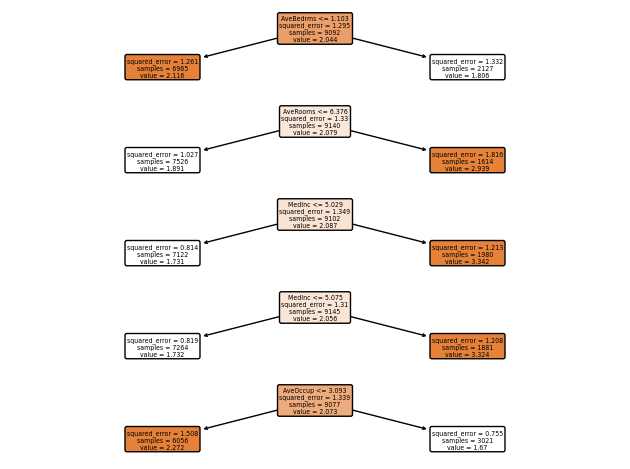

In [80]:
import matplotlib.pyplot as plt
# You can visualise the trees as above - but maybe not more than 5 and not the really big ones ;-)

# The visualisation below assumes a random forest called 'forest' and a parameter 'number_of_trees'. 
# Change in the code below if your naming above is different

for treeid in range(number_of_trees):
    dot_data = tree.export_graphviz(forest.estimators_[treeid], feature_names=dataset.feature_names, out_file=None, filled=True, rounded=True, special_characters=True)
    graph = graphviz.Source(dot_data, format="png") 
    graph.render("forest_treeid"+str(treeid))

fig, ax = plt.subplots(number_of_trees,1) # use plt.subplots(number_of_trees/2,2) if you want two columns
for i, axi in enumerate(ax.flat):
    axi.set_title("Tree {}".format(i))
    tree.plot_tree(forest.estimators_[i], ax=axi, feature_names=dataset.feature_names, filled=True, rounded=True)
fig.tight_layout()